# *SALE PRICE PREDICTION NYC SALES*

## Importing Data and Others

In [2]:
import pandas as pd
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.model_selection import GridSearchCV

df = pd.read_csv("nyc-rolling-sales.csv")

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.naive_bayes import GaussianNB

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.decomposition import PCA

## Presenting the Data

In [3]:
df.head(10)

,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
0,4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,392,6,,C2,153 AVENUE B,...,5,0,5,1633,6440,1900,2,C2,6625000,2017-07-19 00:00:00
1,5,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,26,,C7,234 EAST 4TH STREET,...,28,3,31,4616,18690,1900,2,C7,-,2016-12-14 00:00:00
2,6,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,39,,C7,197 EAST 3RD STREET,...,16,1,17,2212,7803,1900,2,C7,-,2016-12-09 00:00:00
3,7,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,402,21,,C4,154 EAST 7TH STREET,...,10,0,10,2272,6794,1913,2,C4,3936272,2016-09-23 00:00:00
4,8,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,404,55,,C2,301 EAST 10TH STREET,...,6,0,6,2369,4615,1900,2,C2,8000000,2016-11-17 00:00:00
5,9,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,405,16,,C4,516 EAST 12TH STREET,...,20,0,20,2581,9730,1900,2,C4,-,2017-07-20 00:00:00
6,10,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,406,32,,C4,210 AVENUE B,...,8,0,8,1750,4226,1920,2,C4,3192840,2016-09-23 00:00:00
7,11,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,407,18,,C7,520 EAST 14TH STREET,...,44,2,46,5163,21007,1900,2,C7,-,2017-07-20 00:00:00
8,12,1,ALPHABET CITY,08 RENTALS - ELEVATOR APARTMENTS,2,379,34,,D5,141 AVENUE D,...,15,0,15,1534,9198,1920,2,D5,-,2017-06-20 00:00:00
9,13,1,ALPHABET CITY,08 RENTALS - ELEVATOR APARTMENTS,2,387,153,,D9,629 EAST 5TH STREET,...,24,0,24,4489,18523,1920,2,D9,16232000,2016-11-07 00:00:00


In [4]:
df.tail(10)

,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
84538,8404,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,61,,B2,178 DARNELL LANE,...,2,0,2,3215,1300,1995,1,B2,-,2017-06-30 00:00:00
84539,8405,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,85,,B2,137 DARNELL LANE,...,2,0,2,3016,1300,1995,1,B2,-,2016-12-30 00:00:00
84540,8406,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,93,,B2,125 DARNELL LANE,...,2,0,2,3325,1300,1995,1,B2,509000,2016-10-31 00:00:00
84541,8407,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7317,126,,B2,112 ROBIN COURT,...,2,0,2,11088,2160,1994,1,B2,648000,2016-12-07 00:00:00
84542,8408,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7339,41,,B9,41 SONIA COURT,...,2,0,2,3020,1800,1997,1,B9,-,2016-12-01 00:00:00
84543,8409,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,34,,B9,37 QUAIL LANE,...,2,0,2,2400,2575,1998,1,B9,450000,2016-11-28 00:00:00
84544,8410,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,78,,B9,32 PHEASANT LANE,...,2,0,2,2498,2377,1998,1,B9,550000,2017-04-21 00:00:00
84545,8411,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7351,60,,B2,49 PITNEY AVENUE,...,2,0,2,4000,1496,1925,1,B2,460000,2017-07-05 00:00:00
84546,8412,5,WOODROW,22 STORE BUILDINGS,4,7100,28,,K6,2730 ARTHUR KILL ROAD,...,0,7,7,208033,64117,2001,4,K6,11693337,2016-12-21 00:00:00
84547,8413,5,WOODROW,35 INDOOR PUBLIC AND CULTURAL FACILITIES,4,7105,679,,P9,155 CLAY PIT ROAD,...,0,1,1,10796,2400,2006,4,P9,69300,2016-10-27 00:00:00


In [5]:
df.shape

(84548, 22)

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84548 entries, 0 to 84547
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Unnamed: 0                      84548 non-null  int64 
 1   BOROUGH                         84548 non-null  int64 
 2   NEIGHBORHOOD                    84548 non-null  object
 3   BUILDING CLASS CATEGORY         84548 non-null  object
 4   TAX CLASS AT PRESENT            84548 non-null  object
 5   BLOCK                           84548 non-null  int64 
 6   LOT                             84548 non-null  int64 
 7   EASE-MENT                       84548 non-null  object
 8   BUILDING CLASS AT PRESENT       84548 non-null  object
 9   ADDRESS                         84548 non-null  object
 10  APARTMENT NUMBER                84548 non-null  object
 11  ZIP CODE                        84548 non-null  int64 
 12  RESIDENTIAL UNITS               84548 non-null

As it is possible to see above, we have several different types of data that are both categorical and continous. Before creating the models necassary for this assignment, we need to convert them to the appropriate types. 

*The countinous features being :*

- SALE PRICE
- LAND SQUARE FEET
    - The land area of the property listed in square feet
    
- GROSS SQUARE FEET 
    - The total area of all the floors of a building as measured from the exterior surfaces of the outside    walls of the
      building, including the land area and space within any building or structure on the property.
      
- SALE DATE (Which will be converted to MONTH SOLD and YEAR SOLD)
    - 
    
- COMMERCIAL UNITS
    - The number of commercial units at the listed property.
    
- RESIDENTIAL UNITS 
    - The number of residential units at the listed property.
    
- TOTAL UNITS
    - The total number of units at the listed property.
    
- BLOCK
    - Because there are more than 11k unique blocks in the dataset, it doesn't make sense to define it as a categorical 
      variable
      
- LOT
    - The same reason as 'BLOCK' feature

*The categorical features being :*

- BOROUGH
    - A digit code for the borough the property is located in; in order these are Manhattan (1), Bronx (2), Brooklyn (3),
      Queens (4), and Staten Island (5).
      
- NEIGHBORHOOD
    - Names of the neighboohoods that work better as a categorical feature than a numerical
    
- ZIP CODE
    - The property’s postal code.
    
- BUILDING CLASS CATEGORY
    - Easier identifiable categories of the possible types of buldings 
    
- TAX CLASS AT PRESENT
    - Every property in the city is assigned to one of four tax classes, based on the use of the property.
    
- BUILDING CLASS AT PRESENT
    - The Building Classification is used to describe a property’s constructive use. The first position of the Building Class
      is a letter that is used to describe a general class of properties. The second position, a number, adds more specific
      information about the property’s use or construction style.
      
- YEAR BUILT
    - Year the structure on the property was built.
    
- TAX CLASS AT TIME OF SALE
    - See 'TAX CLASS AT PRESENT'
    
- BUILDING CLASS AT TIME OF SALE
    - See 'BUILDING CLASS AT PRSENT'

*The features we defintely dont need is :*

- Unnamed: 0 
    - Dropping as it looks like an iterator
    
- EASE-MENT 
    - Because it only contains NaN values
    
- APARTMENT NUMBER 
    - The number of the apartment is not relevant for sale price
    
- ADDRESS
    - Address is just listed as names and will not be usefull for the sales price prediction

# Cleaning the Overall Data

In [7]:
df = df.drop(['EASE-MENT', 'Unnamed: 0', 'APARTMENT NUMBER', "ADDRESS"], axis=1)

In [8]:
#Checking for any duplicates

sum(df.duplicated(df.columns))

956

In [9]:
# Removing duplicates

df = df.drop_duplicates(df.columns, keep='last')
sum(df.duplicated(df.columns))

0

In [10]:
#Checking if there are any null values in the dataframe

df.isna().any(), df.isnull().any()

(BOROUGH                           False
 NEIGHBORHOOD                      False
 BUILDING CLASS CATEGORY           False
 TAX CLASS AT PRESENT              False
 BLOCK                             False
 LOT                               False
 BUILDING CLASS AT PRESENT         False
 ZIP CODE                          False
 RESIDENTIAL UNITS                 False
 COMMERCIAL UNITS                  False
 TOTAL UNITS                       False
 LAND SQUARE FEET                  False
 GROSS SQUARE FEET                 False
 YEAR BUILT                        False
 TAX CLASS AT TIME OF SALE         False
 BUILDING CLASS AT TIME OF SALE    False
 SALE PRICE                        False
 SALE DATE                         False
 dtype: bool,
 BOROUGH                           False
 NEIGHBORHOOD                      False
 BUILDING CLASS CATEGORY           False
 TAX CLASS AT PRESENT              False
 BLOCK                             False
 LOT                               False
 B

In [11]:
# Replacing empty or '-' values with NaN

df = df.replace(' ', np.nan)
df = df.replace(' -  ', np.nan)

In [12]:
#An overview of where there is any NaN values

print("Percentage null or na values in Dataset\n-------------------------------------")
((df.isnull() | df.isna()).sum() * 100 / df.index.size).round(2)

Percentage null or na values in Dataset
-------------------------------------


BOROUGH                            0.00
NEIGHBORHOOD                       0.00
BUILDING CLASS CATEGORY            0.00
TAX CLASS AT PRESENT               0.88
BLOCK                              0.00
LOT                                0.00
BUILDING CLASS AT PRESENT          0.88
ZIP CODE                           0.00
RESIDENTIAL UNITS                  0.00
COMMERCIAL UNITS                   0.00
TOTAL UNITS                        0.00
LAND SQUARE FEET                  31.05
GROSS SQUARE FEET                 32.64
YEAR BUILT                         0.00
TAX CLASS AT TIME OF SALE          0.00
BUILDING CLASS AT TIME OF SALE     0.00
SALE PRICE                        16.84
SALE DATE                          0.00
dtype: float64

### Removing some of the features

Before further inspections, we decided to remove some more of the features. These are:

- "ZIP CODE" : Not relevant

- "BLOCK" : Not relevant

- "LOT" : Not relvant

In [13]:
df = df.drop(['ZIP CODE', 'BLOCK', 'LOT'], axis=1)

## Cleaning Sale Price

In [14]:
#Dropping all the NaN values

df = df.dropna(subset=['SALE PRICE'])

In [15]:
#Converting ['SALE PRICE'] from object to float

df["SALE PRICE"] = df["SALE PRICE"].astype(float)

In [16]:
df['SALE PRICE'].describe()

count    6.951800e+04
mean     1.281950e+06
std      1.143759e+07
min      0.000000e+00
25%      2.300000e+05
50%      5.345810e+05
75%      9.500000e+05
max      2.210000e+09
Name: SALE PRICE, dtype: float64

In [17]:
#Checking how the values look

df['SALE PRICE'].value_counts().head(10)

0.0         9978
10.0         746
450000.0     426
550000.0     416
650000.0     413
600000.0     409
700000.0     382
400000.0     377
750000.0     376
500000.0     350
Name: SALE PRICE, dtype: int64

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


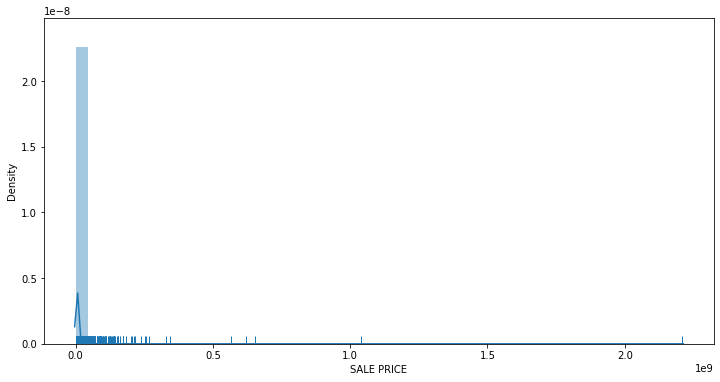

In [18]:
# Making a diagram to get a clearer view of how 'SALE PRICE' is distributed

plt.figure(figsize=(12,6))
sns.distplot(df['SALE PRICE'], kde=True, bins=50, rug=True)
plt.show()

In [19]:
# This shows that around 18% of the values are either greater than 10.000.000 or less than 10.000. 

df[(df['SALE PRICE'] < 10000) | (df['SALE PRICE'] > 10000000)]['SALE PRICE'].count() /len(df) 

0.1752927299404471

In [20]:
# We than remove the values that are either greater than 1.000.000 or less than 10.000 to get a better distributed feature

df= df[(df['SALE PRICE'] > 10000) & (df['SALE PRICE']<10000000)]

In [21]:
df['SALE PRICE'].value_counts().head(10)

450000.0    426
550000.0    416
650000.0    413
600000.0    409
700000.0    382
400000.0    377
750000.0    376
500000.0    350
300000.0    348
350000.0    341
Name: SALE PRICE, dtype: int64

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


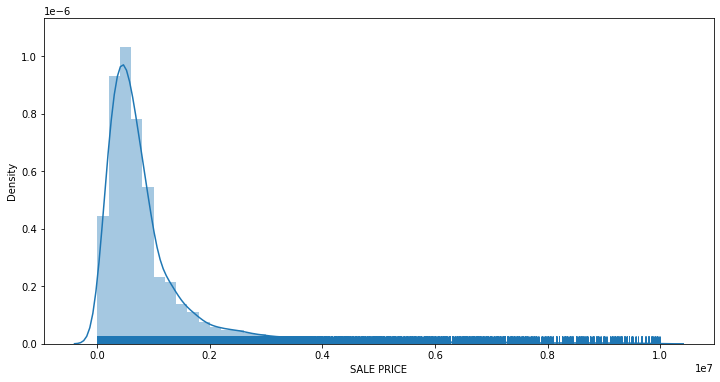

In [22]:
plt.figure(figsize=(12,6))
sns.distplot(df['SALE PRICE'], kde=True, bins=50, rug=True)
plt.show()

## Cleaning Square Feet

There are a lot of missing values in these features.
We can either fill them up with the mean average or remove them like this:

For the time being, lets remove this missing features

In [23]:
#Dropping all the NaN values

df = df.dropna(subset=['LAND SQUARE FEET'])
df = df.dropna(subset=['GROSS SQUARE FEET'])

In [24]:
#Converting from object to float

df['LAND SQUARE FEET'] = df['LAND SQUARE FEET'].astype(float)
df['GROSS SQUARE FEET'] = df['GROSS SQUARE FEET'].astype(float)

In [25]:
df['LAND SQUARE FEET'].value_counts().head(10)

0.0       8018
2000.0    2343
2500.0    2083
4000.0    1858
1800.0     758
3000.0     740
5000.0     570
2400.0     328
1900.0     307
6000.0     281
Name: LAND SQUARE FEET, dtype: int64

In [26]:
df['GROSS SQUARE FEET'].value_counts().head(10)

0.0       8444
1800.0     243
1600.0     235
1440.0     232
2400.0     230
2000.0     223
1200.0     200
1280.0     188
3000.0     178
1224.0     164
Name: GROSS SQUARE FEET, dtype: int64

In [27]:
df = df[df['LAND SQUARE FEET'] > 10]

In [28]:
df = df[df['GROSS SQUARE FEET'] > 10]

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


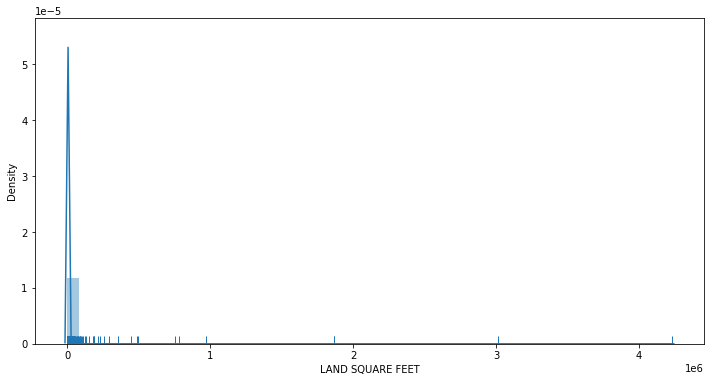

In [29]:
plt.figure(figsize=(12,6))
sns.distplot(df['LAND SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


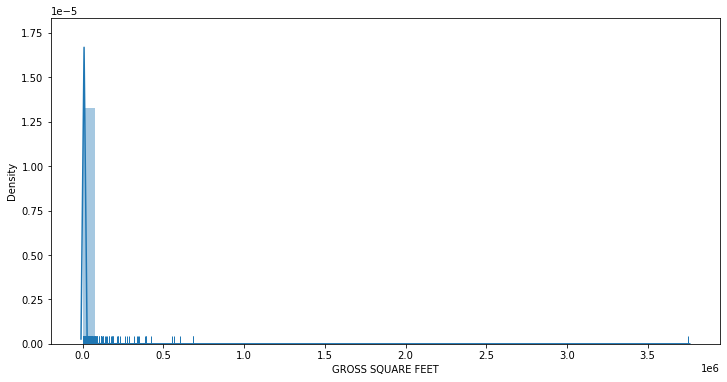

In [30]:
plt.figure(figsize=(12,6))
sns.distplot(df['GROSS SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

As it is possible to see from the diagrams and value_counts(), there are a lot of outliners in these features. 
These have to be cleaned later.

## Cleaning Sale Date

In [31]:
df['SALE DATE'].value_counts().head()

# TimeStamp types are hard to work with. Therefore, we make the 'SALE DATE' feature to two distinct features 'YEAR SOLD' and
# 'MONTH SOLD'. These two features can help us later in further analysis of the data

2017-04-28 00:00:00    192
2016-09-30 00:00:00    180
2017-02-28 00:00:00    179
2016-12-22 00:00:00    179
2016-10-28 00:00:00    176
Name: SALE DATE, dtype: int64

In [32]:
# Making a list with alle the different months 

months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

In [33]:
# Spliting Sale Date into to features, one for Month Sold and one for Year Sold. 
# This is first for making a TimeStamp feature easier to use, and for calculating 
# which month or year had the highest sales rate

df['YEAR SOLD'] = [int(n[0:4]) for n in df['SALE DATE']]
df['MONTH SOLD'] = [int(n[5:7]) for n in df['SALE DATE']]
df = df.drop(['SALE DATE'], axis=1)

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Number of properties sold by year')

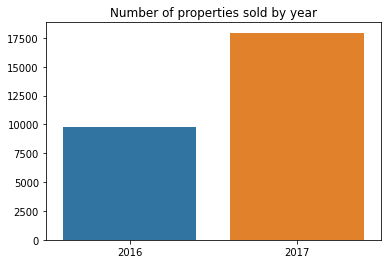

In [34]:
plt.hist(df['YEAR SOLD'], bins=2, color='c')
counts_per_year = [sum(df['YEAR SOLD'] == 2016), sum(df['YEAR SOLD'] == 2017)]
sns.barplot([2016, 2017], counts_per_year).set_title('Number of properties sold by year')

Text(0.5, 1.0, 'Number of properties sold by month')

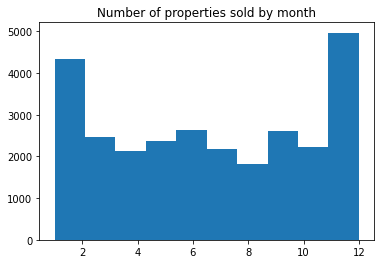

In [35]:
plt.hist(df['MONTH SOLD'])
plt.title('Number of properties sold by month')

The first diagram shows that there were significant more houses sold in 2017 than in 2016, showing an increase that may indicate an even bigger increase in a predictive model for 2018

Its also possible to see big difference in the months january and december, compared to other months.

In [36]:
# Transforming to more appriopriate types

df['MONTH SOLD'] = df['MONTH SOLD'].astype('category')

In [37]:
# Transforming to more appriopriate types


df['YEAR SOLD'] = df['YEAR SOLD'].astype('category')

## Cleaning Tax Class

In [38]:
#Dropping all the NaN values

df = df.dropna(subset=['TAX CLASS AT PRESENT'])

In [39]:
df['TAX CLASS AT TIME OF SALE'].value_counts()

1    24570
2     2018
4     1149
Name: TAX CLASS AT TIME OF SALE, dtype: int64

In [40]:
# Tax classes, as mentioned earlier, should be categorical classes. Therefore, it is more appropriate to
# replace the values to more informative values as shown below

df['TAX CLASS AT TIME OF SALE'] = df['TAX CLASS AT TIME OF SALE'].replace({1:'Class_1',
                                                                           2:'Class_2',
                                                                           4:'Class_4'})

In [41]:
df['TAX CLASS AT PRESENT'].value_counts()

1     24574
2A     1226
4      1148
2       416
2B      372
2C        1
Name: TAX CLASS AT PRESENT, dtype: int64

In [42]:
# Tax classes, as mentioned earlier, should be categorical classes. Therefore, it is more appropriate to
# replace the values to more informative values as shown below

df['TAX CLASS AT PRESENT'] = df['TAX CLASS AT PRESENT'].replace({'1':'Class_1',
                                                                 '1A':'Class_1',
                                                                 '1B':'Class_1',
                                                                 '1C':'Class_1',
                                                                 '2':'Class_2',
                                                                 '2A':'Class_2',
                                                                 '2B':'Class_2',
                                                                 '2C':'Class_2',
                                                                 '3':'Class_3',
                                                                 '4':'Class_4'})

In [43]:
# Converting the features to more appropiate types

df['TAX CLASS AT TIME OF SALE'] = df['TAX CLASS AT TIME OF SALE'].astype('category')
df['TAX CLASS AT PRESENT'] = df['TAX CLASS AT PRESENT'].astype('category')

In [44]:
df['TAX CLASS AT PRESENT'].value_counts()

Class_1    24574
Class_2     2015
Class_4     1148
Name: TAX CLASS AT PRESENT, dtype: int64

In [45]:
df['TAX CLASS AT TIME OF SALE'].value_counts()

Class_1    24570
Class_2     2018
Class_4     1149
Name: TAX CLASS AT TIME OF SALE, dtype: int64

<AxesSubplot:ylabel='TAX CLASS AT PRESENT'>

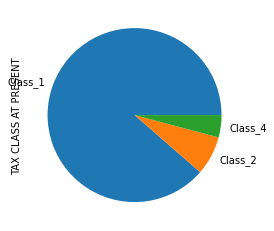

In [46]:
df['TAX CLASS AT PRESENT'].value_counts().plot(kind='pie')

<AxesSubplot:ylabel='TAX CLASS AT TIME OF SALE'>

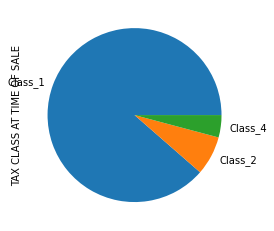

In [47]:
df['TAX CLASS AT TIME OF SALE'].value_counts().plot(kind='pie')

These pie charts show that more the 3/4 of all the values in the features belong to class_1. 

## Cleaning Buliding Class

In [48]:
df['BUILDING CLASS AT TIME OF SALE'].value_counts()

A1    4691
A5    3983
B2    3125
B1    2741
B3    2486
      ... 
O9       1
P8       1
I4       1
P6       1
J4       1
Name: BUILDING CLASS AT TIME OF SALE, Length: 113, dtype: int64

In [49]:
# Converting the features to more appropiate types

df['BUILDING CLASS AT TIME OF SALE'] = df['BUILDING CLASS AT TIME OF SALE'].astype('category')

In [50]:
df['BUILDING CLASS AT PRESENT'].value_counts()

A1    4696
A5    3996
B2    3131
B1    2745
B3    2490
      ... 
P8       1
I4       1
P6       1
RR       1
W1       1
Name: BUILDING CLASS AT PRESENT, Length: 111, dtype: int64

In [51]:
#Dropping all the NaN values

df = df.dropna(subset=['BUILDING CLASS AT PRESENT'])

In [52]:
# Converting the features to more appropiate types

df['BUILDING CLASS AT PRESENT'] = df['BUILDING CLASS AT PRESENT'].astype('category')

As it is possible to se above, 'BUILDING CLASS AT TIME OF SALE' and 'BUILDING CLASS CATEGORY' is almost the same. We might remove one of them to prevent overfitting our model.

In [53]:
df['BUILDING CLASS CATEGORY'].value_counts()

01 ONE FAMILY DWELLINGS                         12534
02 TWO FAMILY DWELLINGS                          9728
03 THREE FAMILY DWELLINGS                        2285
07 RENTALS - WALKUP APARTMENTS                   1607
22 STORE BUILDINGS                                429
14 RENTALS - 4-10 UNIT                            311
29 COMMERCIAL GARAGES                             157
21 OFFICE BUILDINGS                               148
30 WAREHOUSES                                     143
27 FACTORIES                                       93
08 RENTALS - ELEVATOR APARTMENTS                   58
37 RELIGIOUS FACILITIES                            58
26 OTHER HOTELS                                    31
10 COOPS - ELEVATOR APARTMENTS                     30
33 EDUCATIONAL FACILITIES                          21
32 HOSPITAL AND HEALTH FACILITIES                  19
35 INDOOR PUBLIC AND CULTURAL FACILITIES           14
05 TAX CLASS 1 VACANT LAND                         12
23 LOFT BUILDINGS           

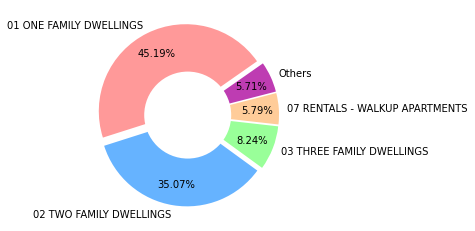

In [54]:
property_types = {'01 ONE FAMILY DWELLINGS': 12534,
 '02 TWO FAMILY DWELLINGS': 9728,
 '03 THREE FAMILY DWELLINGS': 2285,
 '07 RENTALS - WALKUP APARTMENTS': 1607,
 'Others' : 1583}                         # 'Others' here is the sum of fifth - 28th value given above

labels = property_types.keys()
sizes = property_types.values()
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#be3cb2']
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.2f%%',startangle=35, pctdistance=0.75, explode = tuple([0.05] * 5))
centre_circle = plt.Circle((0,0),0.50,fc='#ffffff')
plt.gcf().gca().add_artist(centre_circle)

From the value_count() and Pie Chart above, we can observe that the first four values stands out the most and the rest should rather be one value to remove a lot of outliners. This might be clever to clean.

df['BUILDING CLASS CATEGORY'] = df['BUILDING CLASS CATEGORY'].replace(
    {'01 ONE FAMILY DWELLINGS':'01 ONE FAMILY DWELLINGS',
    '02 TWO FAMILY DWELLINGS': '02 TWO FAMILY DWELLINGS',
    '03 THREE FAMILY DWELLINGS':'03 THREE FAMILY DWELLINGS',
    '07 RENTALS - WALKUP APARTMENTS':'07 RENTALS - WALKUP APARTMENTS',
    '22 STORE BUILDINGS':'Others',
    '14 RENTALS - 4-10 UNIT':'Others',
    '29 COMMERCIAL GARAGES':'Others',
    '21 OFFICE BUILDINGS':'Others',
    '30 WAREHOUSES':'Others',
    '27 FACTORIES':'Others',
    '08 RENTALS - ELEVATOR APARTMENTS':'Others',
    '37 RELIGIOUS FACILITIES':'Others',
    '26 OTHER HOTELS':'Others',
    '10 COOPS - ELEVATOR APARTMENTS':'Others',
    '33 EDUCATIONAL FACILITIES':'Others',
    '32 HOSPITAL AND HEALTH FACILITIES':'Others',
    '35 INDOOR PUBLIC AND CULTURAL FACILITIES':'Others',
    '05 TAX CLASS 1 VACANT LAND':'Others',
    '23 LOFT BUILDINGS':'Others',
    '38 ASYLUMS AND HOMES':'Others',
    '06 TAX CLASS 1 - OTHER':'Others',
    '41 TAX CLASS 4 - OTHER':'Others',
    '09 COOPS - WALKUP APARTMENTS':'Others',
    '34 THEATRES':'Others',
    '11 SPECIAL CONDO BILLING LOTS':'Others',
    '11A CONDO-RENTALS':'Others',
    '36 OUTDOOR RECREATIONAL FACILITIES':'Others',
    '31 COMMERCIAL VACANT LAND':'Others'})

In [55]:
# Converting the features to more appropiate types

df['BUILDING CLASS CATEGORY'] = df['BUILDING CLASS CATEGORY'].astype('category')

## Cleaning Borough

In [56]:
df['BOROUGH'].value_counts()

4    10679
3     8206
5     4900
2     3346
1      606
Name: BOROUGH, dtype: int64

In [57]:
# Change borough index to borough real name in New York City

df['BOROUGH'][df['BOROUGH'] == 1] = 'Manhattan'
df['BOROUGH'][df['BOROUGH'] == 2] = 'Bronx'
df['BOROUGH'][df['BOROUGH'] == 3] = 'Brooklyn'
df['BOROUGH'][df['BOROUGH'] == 4] = 'Queens'
df['BOROUGH'][df['BOROUGH'] == 5] = 'Staten Island'

<ipython-input-57-a4b132a056bf>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['BOROUGH'][df['BOROUGH'] == 1] = 'Manhattan'


In [58]:
df['BOROUGH'] = df['BOROUGH'].astype('category')

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Sales per Borough')

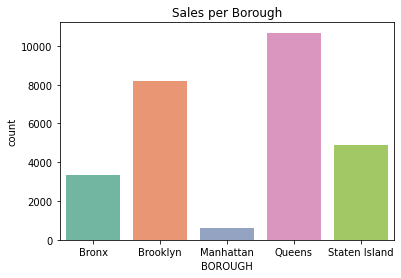

In [59]:
sns.countplot('BOROUGH',data=df,palette='Set2')
plt.title('Sales per Borough')

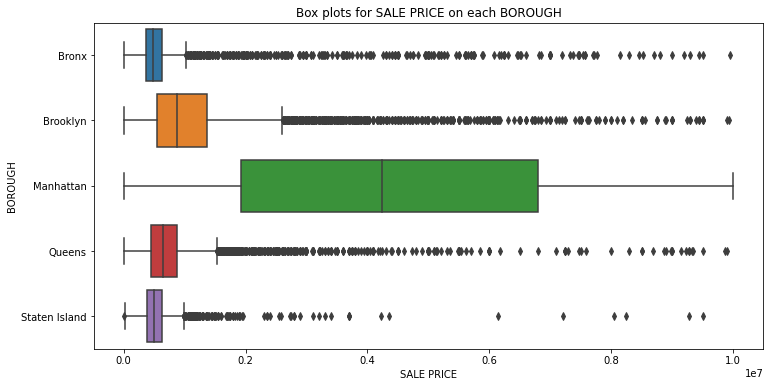

In [60]:
plt.figure(figsize=(12,6))
sns.boxplot(y = 'BOROUGH', x = 'SALE PRICE', data = df )
plt.title('Box plots for SALE PRICE on each BOROUGH')
plt.show()

## Cleaning Year Built

In [61]:
df['YEAR BUILT'].head(10)

0      1900
3      1913
4      1900
6      1920
172    1910
173    1900
174    1910
195    1899
206    1901
212    1920
Name: YEAR BUILT, dtype: int64

/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/snorrealv/uni/machine-learning_284/.venv/lib/python3.8/site-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


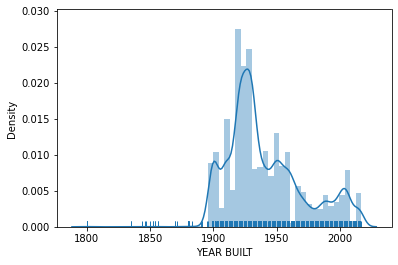

In [62]:
df=df[df['YEAR BUILT']!=0]
sns.distplot(df['YEAR BUILT'], bins=50, rug=True)
plt.show()

In [63]:
#As its possible to se from the graph above, there are some outliners from 1800 - 1900. We can remove these.

df= df[(df['YEAR BUILT'] > 1880)]

In [64]:
#Converting the feature to a more appropriate type

df['YEAR BUILT'] = df['YEAR BUILT'].astype('category')

## Cleaning "... Units"

In [65]:
df['RESIDENTIAL UNITS'].value_counts().head()

1    12626
2     9832
3     2385
0      979
4      673
Name: RESIDENTIAL UNITS, dtype: int64

In [66]:
df['COMMERCIAL UNITS'].value_counts().head()

0    25449
1     1655
2      335
3      104
4       60
Name: COMMERCIAL UNITS, dtype: int64

In [67]:
#Dropping total units because its only the sum of 'RESIDENTIAL UNITS' and 'COMMERCIAL UNITS'

df = df.drop(['TOTAL UNITS'], axis=1)

## Cleaning Neighborhood

In [68]:
df['NEIGHBORHOOD'] = df['NEIGHBORHOOD'].astype('category')

## Overview

In [69]:
#df.head(10)

In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27701 entries, 0 to 84547
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   BOROUGH                         27701 non-null  category
 1   NEIGHBORHOOD                    27701 non-null  category
 2   BUILDING CLASS CATEGORY         27701 non-null  category
 3   TAX CLASS AT PRESENT            27701 non-null  category
 4   BUILDING CLASS AT PRESENT       27701 non-null  category
 5   RESIDENTIAL UNITS               27701 non-null  int64   
 6   COMMERCIAL UNITS                27701 non-null  int64   
 7   LAND SQUARE FEET                27701 non-null  float64 
 8   GROSS SQUARE FEET               27701 non-null  float64 
 9   YEAR BUILT                      27701 non-null  category
 10  TAX CLASS AT TIME OF SALE       27701 non-null  category
 11  BUILDING CLASS AT TIME OF SALE  27701 non-null  category
 12  SALE PRICE        

In [71]:
df.shape

(27701, 15)

In [72]:
df_full = df.copy()

## Data Preprocessing, Making Categorical Data more Appropriate

In [73]:
df['BOROUGH'].unique()

['Manhattan', 'Bronx', 'Brooklyn', 'Queens', 'Staten Island']
Categories (5, object): ['Manhattan', 'Bronx', 'Brooklyn', 'Queens', 'Staten Island']

In [74]:
df['TAX CLASS AT PRESENT'].unique()

['Class_2', 'Class_4', 'Class_1']
Categories (3, object): ['Class_2', 'Class_4', 'Class_1']

In [75]:
df['TAX CLASS AT TIME OF SALE'].unique()

['Class_2', 'Class_4', 'Class_1']
Categories (3, object): ['Class_2', 'Class_4', 'Class_1']

In [76]:
one_hot_features = ['BOROUGH', 'TAX CLASS AT PRESENT', 'TAX CLASS AT TIME OF SALE', 'BUILDING CLASS CATEGORY', 'YEAR SOLD']

In [77]:
one_hot_encoded = pd.get_dummies(df['BOROUGH'])

df = pd.concat([df, one_hot_encoded], axis=1)

df = df.drop(['BOROUGH'], axis = 1)

In [78]:
one_hot_encoded_1 = pd.get_dummies(df['TAX CLASS AT PRESENT'])

df = pd.concat([df, one_hot_encoded_1], axis=1)

df = df.drop(['TAX CLASS AT PRESENT'], axis = 1)

In [79]:
one_hot_encoded_3 = pd.get_dummies(df['TAX CLASS AT TIME OF SALE'])

df = pd.concat([df, one_hot_encoded_3], axis=1)

df = df.drop(['TAX CLASS AT TIME OF SALE'], axis = 1)

In [80]:
df['BUILDING CLASS CATEGORY'].unique()

['07 RENTALS - WALKUP APARTMENTS             ', '14 RENTALS - 4-10 UNIT                     ', '22 STORE BUILDINGS                         ', '01 ONE FAMILY DWELLINGS                    ', '02 TWO FAMILY DWELLINGS                    ', ..., '06 TAX CLASS 1 - OTHER                     ', '35 INDOOR PUBLIC AND CULTURAL FACILITIES   ', '05 TAX CLASS 1 VACANT LAND                 ', '31 COMMERCIAL VACANT LAND                  ', '11 SPECIAL CONDO BILLING LOTS              ']
Length: 27
Categories (27, object): ['07 RENTALS - WALKUP APARTMENTS             ', '14 RENTALS - 4-10 UNIT                     ', '22 STORE BUILDINGS                         ', '01 ONE FAMILY DWELLINGS                    ', ..., '35 INDOOR PUBLIC AND CULTURAL FACILITIES   ', '05 TAX CLASS 1 VACANT LAND                 ', '31 COMMERCIAL VACANT LAND                  ', '11 SPECIAL CONDO BILLING LOTS              ']

In [81]:
one_hot_encoded_4 = pd.get_dummies(df['BUILDING CLASS CATEGORY'])

df = pd.concat([df, one_hot_encoded_4], axis=1)

df = df.drop(['BUILDING CLASS CATEGORY'], axis = 1)

In [82]:
df['NEIGHBORHOOD'].unique()

['ALPHABET CITY', 'CHELSEA', 'CHINATOWN', 'CIVIC CENTER', 'CLINTON', ..., 'TRAVIS', 'WEST NEW BRIGHTON', 'WESTERLEIGH', 'WILLOWBROOK', 'WOODROW']
Length: 245
Categories (245, object): ['ALPHABET CITY', 'CHELSEA', 'CHINATOWN', 'CIVIC CENTER', ..., 'WEST NEW BRIGHTON', 'WESTERLEIGH', 'WILLOWBROOK', 'WOODROW']

In [83]:
label_encoder = LabelEncoder()

df['NEIGHBORHOOD'] = label_encoder.fit_transform(df['NEIGHBORHOOD'])

In [84]:
df['BUILDING CLASS AT PRESENT'].unique()

['C2', 'C4', 'S3', 'S4', 'S5', ..., 'K3', 'W8', 'Z0', 'CM', 'Y3']
Length: 110
Categories (110, object): ['C2', 'C4', 'S3', 'S4', ..., 'W8', 'Z0', 'CM', 'Y3']

In [85]:
label_encoder_2 = LabelEncoder()

df['BUILDING CLASS AT PRESENT'] = label_encoder_2.fit_transform(df['BUILDING CLASS AT PRESENT'])

In [86]:
df['BUILDING CLASS AT TIME OF SALE'].unique()

['C2', 'C4', 'S3', 'S4', 'S5', ..., 'K3', 'W8', 'Z0', 'CM', 'J9']
Length: 112
Categories (112, object): ['C2', 'C4', 'S3', 'S4', ..., 'W8', 'Z0', 'CM', 'J9']

In [87]:
label_encoder_3 = LabelEncoder()

df['BUILDING CLASS AT TIME OF SALE'] = label_encoder_3.fit_transform(df['BUILDING CLASS AT TIME OF SALE'])

In [88]:
df['YEAR BUILT'].unique()

[1900, 1913, 1920, 1910, 1899, ..., 1978, 1943, 1891, 1881, 2017]
Length: 125
Categories (125, int64): [1900, 1913, 1920, 1910, ..., 1943, 1891, 1881, 2017]

In [89]:
label_encoder_4 = LabelEncoder()

df['YEAR BUILT'] = label_encoder_4.fit_transform(df['YEAR BUILT'])

In [90]:
df['YEAR SOLD'].unique()

[2017, 2016]
Categories (2, int64): [2017, 2016]

In [91]:
one_hot_encoded_5 = pd.get_dummies(df['YEAR SOLD'])

df = pd.concat([df, one_hot_encoded_5], axis=1)

df = df.drop(['YEAR SOLD'], axis = 1)

In [92]:
df['MONTH SOLD'].unique()

[7, 9, 11, 1, 4, ..., 10, 8, 5, 6, 3]
Length: 12
Categories (12, int64): [7, 9, 11, 1, ..., 8, 5, 6, 3]

In [93]:
label_encoder_5 = LabelEncoder()

df['MONTH SOLD'] = label_encoder_5.fit_transform(df['MONTH SOLD'])

In [94]:
minmaxdf = df.copy()

### PCA 

In [96]:
# To be able to make the most accurate models, we should use Principal Component Ananlysis (PCA). To do this, we have to use 
# a Standard Scaler 

#df_columns = df.columns
scaler = StandardScaler()

y = df["SALE PRICE"]
x = df.drop(['SALE PRICE'], axis = 1)
x_train, x_test , y_train, y_test = train_test_split(x , y, random_state = 1)

scaler.fit(x_train)

x_train = scaler.transform(x_train)
x_test = scaler.transform(x_test)

pca = PCA(.95)
pca.fit(x_train)
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

lab_enc = LabelEncoder()
y_train2 = lab_enc.fit_transform(y_train)

(20775, 50)
(20775,)
(6926, 50)
(6926,)


In [1]:
svc = LinearSVC().fit(x_train, y_train)
#logisticRegr = LogisticRegression(solver = 'lbfgs').fit(x_train, y_train2)


NameError: name 'LinearSVC' is not defined

In [325]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27701 entries, 0 to 27700
Data columns (total 51 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   NEIGHBORHOOD                                  27701 non-null  float64
 1   BUILDING CLASS AT PRESENT                     27701 non-null  float64
 2   RESIDENTIAL UNITS                             27701 non-null  float64
 3   COMMERCIAL UNITS                              27701 non-null  float64
 4   LAND SQUARE FEET                              27701 non-null  float64
 5   GROSS SQUARE FEET                             27701 non-null  float64
 6   YEAR BUILT                                    27701 non-null  float64
 7   BUILDING CLASS AT TIME OF SALE                27701 non-null  float64
 8   SALE PRICE                                    27701 non-null  float64
 9   MONTH SOLD                                    27701 non-null 

In [318]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27701 entries, 0 to 84547
Data columns (total 15 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   BOROUGH                         27701 non-null  category
 1   NEIGHBORHOOD                    27701 non-null  category
 2   BUILDING CLASS CATEGORY         27701 non-null  category
 3   TAX CLASS AT PRESENT            27701 non-null  category
 4   BUILDING CLASS AT PRESENT       27701 non-null  category
 5   RESIDENTIAL UNITS               27701 non-null  int64   
 6   COMMERCIAL UNITS                27701 non-null  int64   
 7   LAND SQUARE FEET                27701 non-null  float64 
 8   GROSS SQUARE FEET               27701 non-null  float64 
 9   YEAR BUILT                      27701 non-null  category
 10  TAX CLASS AT TIME OF SALE       27701 non-null  category
 11  BUILDING CLASS AT TIME OF SALE  27701 non-null  category
 12  SALE PRICE        

In [322]:
df_con = df_full[["RESIDENTIAL UNITS", "COMMERCIAL UNITS", "LAND SQUARE FEET", "GROSS SQUARE FEET"]]

In [323]:
df_con.head()

,RESIDENTIAL UNITS,COMMERCIAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET
0,5,0,1633.0,6440.0
3,10,0,2272.0,6794.0
4,6,0,2369.0,4615.0
6,8,0,1750.0,4226.0
172,3,1,1520.0,3360.0


In [209]:
minmaxdf_columns = minmaxdf.columns
minmaxscaler = MinMaxScaler()
minmaxdf = minmaxscaler.fit_transform(minmaxdf)

minmaxdf = pd.DataFrame(minmaxdf)
minmaxdf.columns = minmaxdf_columns

minmaxdf.head(10)

,NEIGHBORHOOD,BUILDING CLASS AT PRESENT,RESIDENTIAL UNITS,COMMERCIAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,BUILDING CLASS AT TIME OF SALE,SALE PRICE,MONTH SOLD,...,32 HOSPITAL AND HEALTH FACILITIES,33 EDUCATIONAL FACILITIES,34 THEATRES,35 INDOOR PUBLIC AND CULTURAL FACILITIES,36 OUTDOOR RECREATIONAL FACILITIES,37 RELIGIOUS FACILITIES,38 ASYLUMS AND HOMES,41 TAX CLASS 4 - OTHER,2016,2017
0,0.004098,0.137615,0.002711,0.000000,0.000339,0.001685,0.056452,0.135135,0.662162,0.545455,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.004098,0.155963,0.005423,0.000000,0.000490,0.001780,0.161290,0.153153,0.393020,0.727273,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.004098,0.137615,0.003254,0.000000,0.000513,0.001199,0.056452,0.135135,0.799800,0.909091,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.004098,0.155963,0.004338,0.000000,0.000367,0.001095,0.217742,0.153153,0.318603,0.727273,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.004098,0.889908,0.001627,0.000442,0.000312,0.000864,0.137097,0.882883,0.329329,0.909091,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
5,0.004098,0.899083,0.002169,0.000442,0.000473,0.001463,0.056452,0.891892,0.721221,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
6,0.004098,0.908257,0.002711,0.000442,0.000373,0.000958,0.137097,0.900901,0.474474,0.272727,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
7,0.004098,0.587156,0.000000,0.000442,0.000241,0.000924,0.048387,0.585586,0.369369,0.727273,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
8,0.155738,0.073394,0.000542,0.000000,0.000420,0.000996,0.064516,0.072072,0.742242,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
9,0.155738,0.880734,0.001085,0.000442,0.000461,0.001295,0.217742,0.873874,0.774775,0.272727,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [210]:
pca = PCA(n_components = 2)
pca.fit(df)

PCA(n_components=2)

# SALES PREDICTION

## Supervised Learning

In [211]:
y = df['SALE PRICE']
x = df.drop(['SALE PRICE'], axis = 1)

print("The shape of the target set:", y.shape)
print("The shape of the dataset:", x.shape)

The shape of the target set: (27701,)
The shape of the dataset: (27701, 50)


In [212]:
x_train, x_test , y_train, y_test = train_test_split(x , y, random_state = 1)

print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(20775, 50)
(20775,)
(6926, 50)
(6926,)


In [213]:
rf = RandomForestRegressor(max_depth=10).fit(x_train, y_train)

print("Random Forest Regressor Model")
print()
print("Training set score: {:.2f}".format(rf.score(x_train, y_train)))
print("Test set score: {:.2f}".format(rf.score(x_test, y_test)))

Random Forest Regressor Model

Training set score: 0.84
Test set score: 0.68


In [214]:
nn = MLPRegressor(hidden_layer_sizes= [12,6], activation='relu', alpha = 1)
nn.fit(x_train, y_train)

print("Neural Network Regressor Model")
print()
print("Training set score: {:.2f}".format(nn.score(x_train, y_train)))
print("Test set score: {:.2f}".format(nn.score(x_test, y_test)))

Neural Network Regressor Model

Training set score: 0.64
Test set score: 0.52


In [215]:
Y = minmaxdf['SALE PRICE']
X = minmaxdf.drop(['SALE PRICE'], axis = 1)

In [216]:
X_train, X_test , Y_train, Y_test = train_test_split(X , Y, random_state = 1)

In [217]:
nbg = GaussianNB()
nbg.fit(X_train, Y_train)

print("Gaussian Naive Bayes Model")
print()
print("Training set score: {:.2f}".format(nbg.score(x_train, y_train)))
print("Test set score: {:.2f}".format(nbg.score(x_test, y_test)))

ValueError: Unknown label type: (array([0.00000000e+00, 4.90490589e-06, 4.99499599e-05, ...,
       9.89990088e-01, 9.93669869e-01, 9.94995094e-01]),)

## Unsupervised Learning